### Import relevant libraries

In [1]:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

### Load dataset

In [2]:
data = pd.read_csv("C:/Users/GetInnotized/Downloads/archive/BankChurners.csv")
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.99998


In [3]:
from pandas_profiling import ProfileReport
profile_data = ProfileReport(data, title ="Profiling Report")
profile_data

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                                                                                                                              Non-Null Count  Dtype  
---  ------                                                                                                                              --------------  -----  
 0   CLIENTNUM                                                                                                                           10127 non-null  int64  
 1   Attrition_Flag                                                                                                                      10127 non-null  object 
 2   Customer_Age                                                                                                                        10127 non-null  int64  
 3   Gender                                                                           


### 1. Loyal customers leave the company most.
 

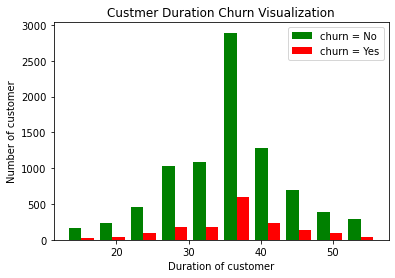

In [5]:
loyal_churn_No = data[data.Attrition_Flag == 'Existing Customer'].Months_on_book 
loyal_churn_Yes = data[data.Attrition_Flag == 'Attrited Customer'].Months_on_book


plt.xlabel('Duration of customer')
plt.ylabel('Number of customer')
plt.title('Custmer Duration Churn Visualization')
plt.rcParams["figure.figsize"] = (12,8)
plt.hist([loyal_churn_No,loyal_churn_Yes], color = ['green', 'red'], label=['churn = No', 'churn = Yes'] )
plt.legend()

From the graph, we realised that customers in the age range of 37 to 40 leave the company more. Surprisingly, this same age group has a lot of existing customers in the company.To that end, the statement that loyal customers are leaving the company most is false.

### 2. Customers with large amount credit limit are not leaving the company

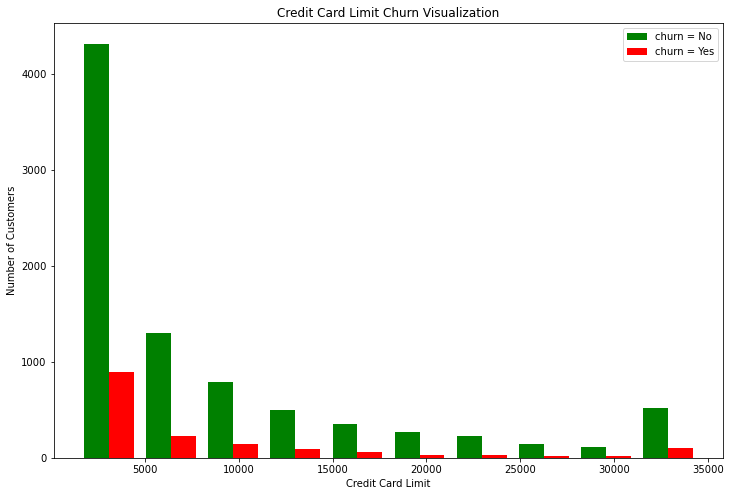

In [6]:
credit_limit_No = data[data.Attrition_Flag == 'Existing Customer'].Credit_Limit
credit_limit_Yes = data[data.Attrition_Flag == 'Attrited Customer'].Credit_Limit


plt.xlabel('Credit Card Limit')
plt.ylabel('Number of Customers')
plt.title('Credit Card Limit Churn Visualization')
plt.rcParams["figure.figsize"] = (12,8)
plt.hist([credit_limit_No,credit_limit_Yes], color = ['green', 'red'], label=['churn = No', 'churn = Yes'] )
plt.legend()

### 3. Customers with blue card category churn more

In [7]:
Category = data.Card_Category.unique()

In [8]:
data.groupby('Card_Category').aggregate({'Attrition_Flag':'value_counts'})

Attrition_Flag
Card_Category Attrition_Flag                   
Blue          Existing Customer            7917
              Attrited Customer            1519
Gold          Existing Customer              95
              Attrited Customer              21
Platinum      Existing Customer              15
              Attrited Customer               5
Silver        Existing Customer             473
              Attrited Customer              82

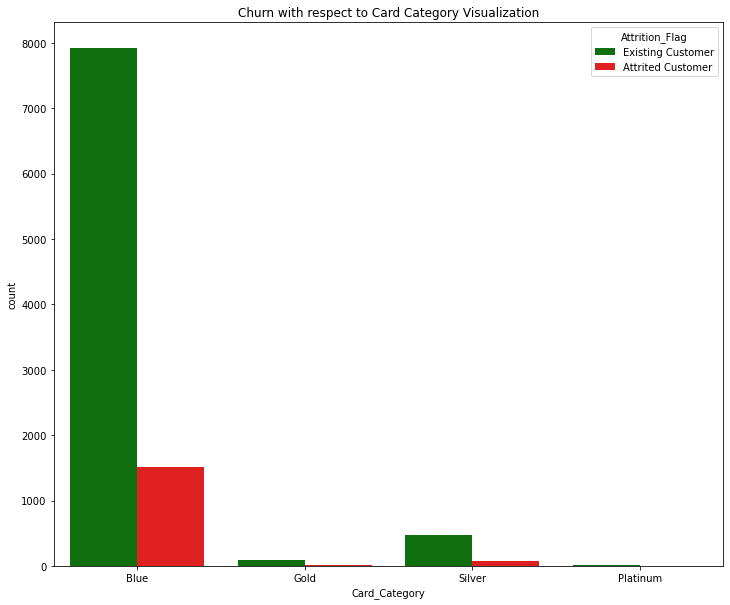

In [9]:
plt.figure(figsize=(12,10))

colors = ["green", "red",]
labels = ['Existing Customer', 'Attrited Customer']
sns.set_palette(sns.color_palette(colors))

sns.countplot(data=data,x='Card_Category',hue='Attrition_Flag')
plt.title('Churn with respect to Card Category Visualization')
plt.show()

### 4. Customers with low revolving balance are most likely to churn

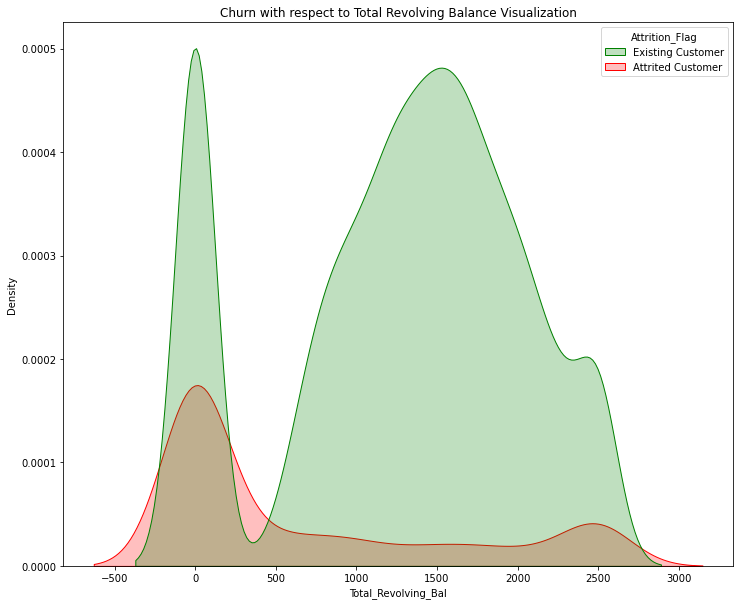

In [10]:
plt.figure(figsize=(12,10))

colors = ["green", "red",]
labels = ['Existing Customer', 'Attrited Customer']
sns.set_palette(sns.color_palette(colors))

sns.kdeplot(data=data,x='Total_Revolving_Bal',hue='Attrition_Flag', shade = True)
plt.title('Churn with respect to Total Revolving Balance Visualization')
plt.show()

### 5. Customers who earn more than 120k+ churn more

In [11]:
data.groupby('Income_Category').aggregate({'Attrition_Flag':'value_counts'})

Attrition_Flag
Income_Category Attrition_Flag                   
$120K +         Existing Customer             601
                Attrited Customer             126
$40K - $60K     Existing Customer            1519
                Attrited Customer             271
$60K - $80K     Existing Customer            1213
                Attrited Customer             189
$80K - $120K    Existing Customer            1293
                Attrited Customer             242
Less than $40K  Existing Customer            2949
                Attrited Customer             612
Unknown         Existing Customer             925
                Attrited Customer             187

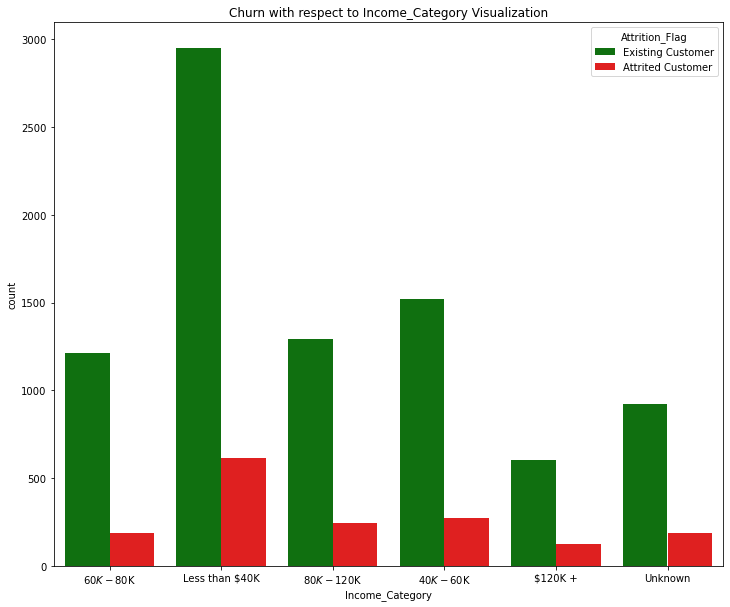

In [12]:
plt.figure(figsize=(12,10))

colors = ["green", "red",]
labels = ['Existing Customer', 'Attrited Customer']
sns.set_palette(sns.color_palette(colors))

sns.countplot(data=data,x='Income_Category',hue='Attrition_Flag')
plt.title('Churn with respect to Income_Category Visualization')
plt.show()

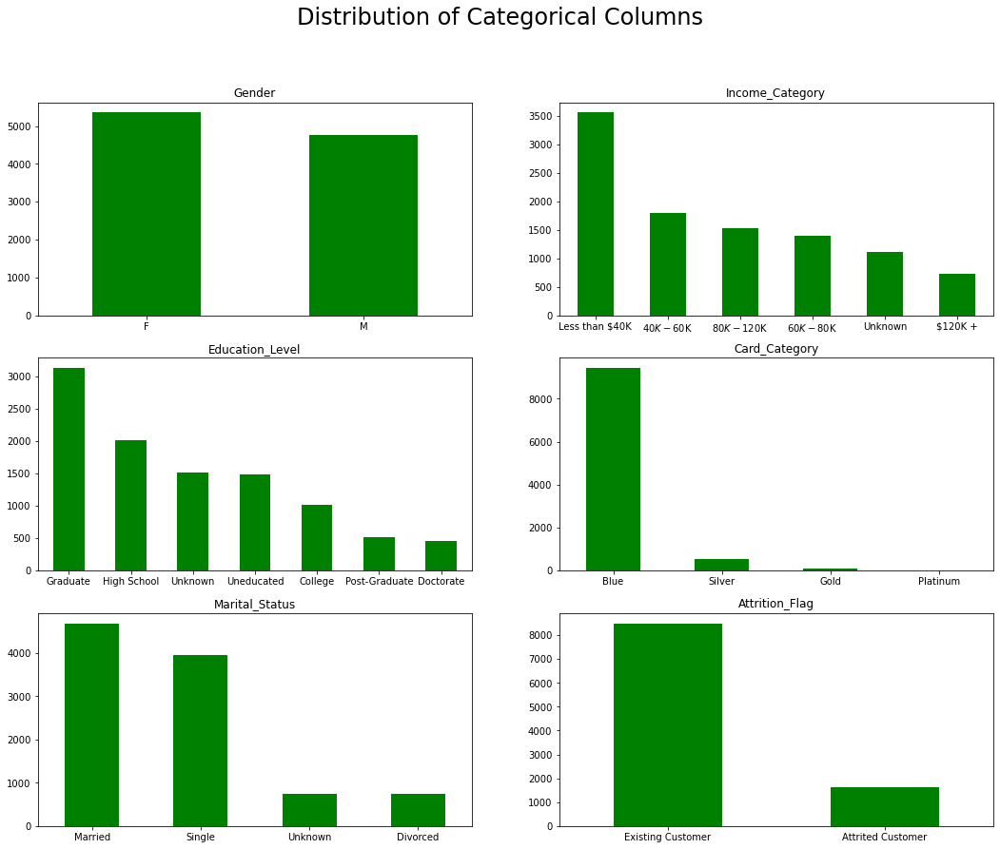

In [13]:
# Distribution of Categorical Values
Categorical_values = data[['Gender', 'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category', 'Attrition_Flag']]

fig, axes = plt.subplots(nrows = 3,ncols = 2, figsize = (18,14))

plt.suptitle('Distribution of Categorical Columns\n',horizontalalignment="center",fontstyle = "normal", fontsize = 24, fontfamily = "sans-serif")
for i, item in enumerate(Categorical_values):
    if i < 3:
        ax = data[item].value_counts().plot(kind = 'bar',ax=axes[i,0],rot = 0, color='green')
        
    elif i >=3 and i < 6:
        ax = data[item].value_counts().plot(kind = 'bar',ax=axes[i-3,1],rot = 0)
    ax.set_title(item)

#### Quick Observations

1. Majority of our customers are graduate degree holders
2. Customers who are divorced or have their status unknown form minority of our client base.
3. A lot of our customers prefer blue card to the other card category.
4. Less than half of our customers are leaving the organization.

# Feature Engineering

In [14]:
# We want to drop Client Number column as it is not necessary

data.drop(labels =['CLIENTNUM','Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2','Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1'], axis = 'columns', inplace =True)

In [15]:
data.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


### Check for Class Imbalance Data

<Figure size 576x576 with 0 Axes>

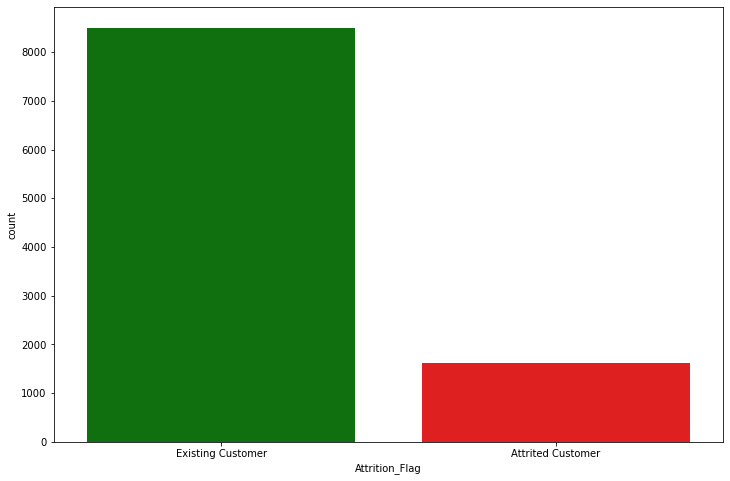

<Figure size 576x576 with 0 Axes>

In [16]:
colors = ["green", "red",]
labels = ['Existing Customer', 'Attrited Customer']
sns.set_palette(sns.color_palette(colors))
sns.countplot(data.Attrition_Flag)
plt.figure(figsize=(8,8))

In [17]:
for column in data:
    if data[column].dtypes=='object':
        print(f'{column} :{data[column].unique()}')

Attrition_Flag :['Existing Customer' 'Attrited Customer']
Gender :['M' 'F']
Education_Level :['High School' 'Graduate' 'Uneducated' 'Unknown' 'College' 'Post-Graduate'
 'Doctorate']
Marital_Status :['Married' 'Single' 'Unknown' 'Divorced']
Income_Category :['$60K - $80K' 'Less than $40K' '$80K - $120K' '$40K - $60K' '$120K +'
 'Unknown']
Card_Category :['Blue' 'Gold' 'Silver' 'Platinum']


In [18]:
# Convert columns to binary integers

data['Gender'].replace({'M':0, 'F':1}, inplace=True)
data['Attrition_Flag'].replace({'Existing Customer':0, 'Attrited Customer':1}, inplace=True)

In [19]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()
data["Gender"] = label_encoder.fit_transform(data["Gender"])

In [20]:
data['Attrition_Flag'].unique()

array([0, 1], dtype=int64)

### Label Encode Education Column in a ranked form

The idea of label encoding here is to help us encode our categorical values in the education column to a ranked format. In the Education column, we need to rank categories from "unknown" to "Doctorate" in order of importance or weight.

In [21]:
data["Education_Level"].unique()

array(['High School', 'Graduate', 'Uneducated', 'Unknown', 'College',
       'Post-Graduate', 'Doctorate'], dtype=object)

In [22]:
level = ["Unknown", "Uneducated", "High School", "College", "Graduate", "Post-Graduate", "Doctorate"]

In [23]:
from sklearn.preprocessing import OrdinalEncoder
ordinal_encoder = OrdinalEncoder(categories=[level])
ordinal_encoder.fit(data[["Education_Level"]])
data["Education_Level"] = ordinal_encoder.transform(data[["Education_Level"]])

In [24]:
data.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,45,0,3,2.0,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,49,1,5,4.0,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,51,0,3,4.0,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,0,40,1,4,2.0,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,0,40,0,3,1.0,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


### One Hot Encoding

In [25]:
from sklearn.preprocessing import OneHotEncoder

cat_cols = data[["Marital_Status", "Income_Category", "Card_Category"]]

ohe = OneHotEncoder(drop = 'first', sparse=False)
transformed = ohe.fit_transform(cat_cols)

transformed_df = pd.DataFrame(transformed, columns=ohe.get_feature_names())

In [26]:
transformed_df.head()

,x0_Married,x0_Single,x0_Unknown,x1_$40K - $60K,x1_$60K - $80K,x1_$80K - $120K,x1_Less than $40K,x1_Unknown,x2_Gold,x2_Platinum,x2_Silver
0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [27]:
transformed_df.shape

(10127, 11)

In [28]:
data_new = data.drop(["Marital_Status", "Income_Category", "Card_Category"], axis = 1)

In [29]:
data_new.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,45,0,3,2.0,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,49,1,5,4.0,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,51,0,3,4.0,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,0,40,1,4,2.0,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,0,40,0,3,1.0,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [30]:
data_new1 = pd.concat([data_new,transformed_df], axis = 1)

In [31]:
data.shape

(10127, 20)

In [32]:
data_new1

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,...,x0_Single,x0_Unknown,x1_$40K - $60K,x1_$60K - $80K,x1_$80K - $120K,x1_Less than $40K,x1_Unknown,x2_Gold,x2_Platinum,x2_Silver
0,0,45,0,3,2.0,39,5,1,3,12691.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0,49,1,5,4.0,44,6,1,2,8256.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,0,51,0,3,4.0,36,4,1,0,3418.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,0,40,1,4,2.0,34,3,4,1,3313.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,0,40,0,3,1.0,21,5,1,0,4716.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,0,50,0,2,4.0,40,3,2,3,4003.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10123,1,41,0,2,0.0,25,4,2,3,4277.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10124,1,44,1,1,2.0,36,5,3,4,5409.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
10125,1,30,0,2,4.0,36,4,3,3,5281.0,...,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Split data into Predictor and Response Variable

In [33]:
X = data_new1.drop(["Attrition_Flag"], axis =1, inplace=False)
y = data_new1["Attrition_Flag"]

### Standardization & Normalization

The purpose of standardization and Normalization is to bring the data to a common scale. Standardization brings data to a range where the mean is 0 and standard deviation is 1. Normalization on the other hand brings data to a close range. We use the StandardScaler from the sklearn.preprocessing library to achieve this result.

In [34]:
from sklearn.preprocessing import StandardScaler

In [35]:
scaled_data = StandardScaler().fit_transform(X)
scaled_data = pd.DataFrame(data = scaled_data )
scaled_data.columns = X.columns.values

In [36]:
scaled_data

,Customer_Age,Gender,Dependent_count,Education_Level,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,...,x0_Single,x0_Unknown,x1_$40K - $60K,x1_$60K - $80K,x1_$80K - $120K,x1_Less than $40K,x1_Unknown,x2_Gold,x2_Platinum,x2_Silver
0,-0.165406,-1.059956,0.503368,-0.354022,0.384621,0.763943,-1.327136,0.492404,0.446622,-0.473422,...,-0.798507,-0.282609,-0.463363,2.494645,-0.422675,-0.736437,-0.351212,-0.107644,-0.044484,-0.240794
1,0.333570,0.943436,2.043199,0.822218,1.010715,1.407306,-1.327136,-0.411616,-0.041367,-0.366667,...,1.252337,-0.282609,-0.463363,-0.400859,-0.422675,1.357890,-0.351212,-0.107644,-0.044484,-0.240794
2,0.583058,-1.059956,0.503368,0.822218,0.008965,0.120579,-1.327136,-2.219655,-0.573698,-1.426858,...,-0.798507,-0.282609,-0.463363,-0.400859,2.365881,-0.736437,-0.351212,-0.107644,-0.044484,-0.240794
3,-0.789126,0.943436,1.273283,-0.354022,-0.241473,-0.522785,1.641478,-1.315636,-0.585251,1.661686,...,-0.798507,3.538459,-0.463363,-0.400859,-0.422675,1.357890,-0.351212,-0.107644,-0.044484,-0.240794
4,-0.789126,-1.059956,0.503368,-0.942142,-1.869317,0.763943,-1.327136,-2.219655,-0.430877,-1.426858,...,-0.798507,-0.282609,-0.463363,2.494645,-0.422675,-0.736437,-0.351212,-0.107644,-0.044484,-0.240794
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,0.458314,-1.059956,-0.266547,0.822218,0.509840,-0.522785,-0.337598,0.492404,-0.509330,0.844455,...,1.252337,-0.282609,2.158134,-0.400859,-0.422675,-0.736437,-0.351212,-0.107644,-0.044484,-0.240794
10123,-0.664382,-1.059956,-0.266547,-1.530263,-1.368442,0.120579,-0.337598,0.492404,-0.479181,1.255524,...,-0.798507,-0.282609,2.158134,-0.400859,-0.422675,-0.736437,-0.351212,-0.107644,-0.044484,-0.240794
10124,-0.290150,0.943436,-1.036462,-0.354022,0.008965,0.763943,0.651940,1.396424,-0.354626,-1.426858,...,-0.798507,-0.282609,-0.463363,-0.400859,-0.422675,1.357890,-0.351212,-0.107644,-0.044484,-0.240794
10125,-2.036565,-1.059956,-0.266547,0.822218,0.008965,0.120579,0.651940,0.492404,-0.368710,-1.426858,...,-0.798507,3.538459,2.158134,-0.400859,-0.422675,-0.736437,-0.351212,-0.107644,-0.044484,-0.240794


In [37]:
scaled_data.describe().round(2)

,Customer_Age,Gender,Dependent_count,Education_Level,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,...,x0_Single,x0_Unknown,x1_$40K - $60K,x1_$60K - $80K,x1_$80K - $120K,x1_Less than $40K,x1_Unknown,x2_Gold,x2_Platinum,x2_Silver
count,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,...,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00,10127.00
mean,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00,...,0.00,-0.00,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-2.54,-1.06,-1.81,-1.53,-2.87,-1.81,-2.32,-2.22,-0.79,-1.43,...,-0.80,-0.28,-0.46,-0.40,-0.42,-0.74,-0.35,-0.11,-0.04,-0.24
25%,-0.66,-1.06,-1.04,-0.94,-0.62,-0.52,-0.34,-0.41,-0.67,-0.99,...,-0.80,-0.28,-0.46,-0.40,-0.42,-0.74,-0.35,-0.11,-0.04,-0.24
50%,-0.04,0.94,-0.27,0.23,0.01,0.12,-0.34,-0.41,-0.45,0.14,...,-0.80,-0.28,-0.46,-0.40,-0.42,-0.74,-0.35,-0.11,-0.04,-0.24
75%,0.71,0.94,0.50,0.82,0.51,0.76,0.65,0.49,0.27,0.76,...,1.25,-0.28,-0.46,-0.40,-0.42,1.36,-0.35,-0.11,-0.04,-0.24
max,3.33,0.94,2.04,2.00,2.51,1.41,3.62,3.20,2.85,1.66,...,1.25,3.54,2.16,2.49,2.37,1.36,2.85,9.29,22.48,4.15


### Split Data into Train & Test data

In [38]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 42)

# X_train: independent/input feature data for training the model
# y_train: dependent/output feature data for training the model
# X_test: independent/input feature data for testing the model; will be used to predict the output values
# y_test: original dependent/output values of X_test; We will compare this values with our predicted values to check the performance of our built model.

### Perform SMOTE sampling

In [39]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=27, sampling_strategy=1.0)
X_train_re, y_train_re = sm.fit_resample(X_train, y_train)

In [40]:
np.unique(y_train_re, return_counts = True)

(array([0, 1], dtype=int64), array([5957, 5957], dtype=int64))

# Model Building

After our EDA and Feature Engineering, we want to build our models now. Some of the classification models are - Logistic Regression, Random Forest Classifier, Decision Tree Classifier, etc.

Firstly, I train baseline model as Logistic Regression after which other models are trained and evaluated against the baseline.

### 1. Logistic Regression

In [41]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, fbeta_score

lr = LogisticRegression()
lr.fit(X_train_re, y_train_re)

# Predicting the Test set results
y_pred  = lr.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

results = pd.DataFrame([['Logistic Regression', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
print (results)


                 Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  Logistic Regression  0.779533   0.402902  0.727823  0.518678  0.626736


### 2. Support Vector Machines

In [42]:
from sklearn.svm import SVC

svc = SVC(kernel ='rbf')
svc.fit(X_train_re, y_train_re)

# Predicting the Test set results
y_pred  = svc.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

model_results = pd.DataFrame([['SVC', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
results = results.append(model_results, ignore_index = True)
print (results)

                 Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  Logistic Regression  0.779533   0.402902  0.727823  0.518678  0.626736
1                  SVC  0.712076   0.324374  0.705645  0.444444  0.571335


### 3. KNN

In [43]:
from sklearn.neighbors import KNeighborsClassifier

KNN = KNeighborsClassifier(n_neighbors = 3)
KNN.fit(X_train_re, y_train_re)

# Predicting the Test set results
y_pred  = KNN.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

model_results = pd.DataFrame([['KNN', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
results = results.append(model_results, ignore_index = True)
print (results)

                 Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  Logistic Regression  0.779533   0.402902  0.727823  0.518678  0.626736
1                  SVC  0.712076   0.324374  0.705645  0.444444  0.571335
2                  KNN  0.844357   0.516595  0.721774  0.602187  0.668659


###### We train tree models on imbalanced data

### 4. Decision Tree

In [44]:
from sklearn.tree import DecisionTreeClassifier
# Fitting Decision Tree to the Training set

dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)

# Predicting the Test set results
y_pred  = dt.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

model_results = pd.DataFrame([['Decision Tree', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
results = results.append(model_results, ignore_index = True)
print (results)

                 Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  Logistic Regression  0.779533   0.402902  0.727823  0.518678  0.626736
1                  SVC  0.712076   0.324374  0.705645  0.444444  0.571335
2                  KNN  0.844357   0.516595  0.721774  0.602187  0.668659
3        Decision Tree  0.929911   0.788187  0.780242  0.784195  0.781818


### 5. Gradient Boosting 

In [45]:
import xgboost as xgb 
xgc = xgb.XGBClassifier(n_estimators=500, max_depth=5, random_state=42) 
xgc.fit(X_train, y_train)

# Predicting the Test set results
y_pred  = xgc.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

model_results = pd.DataFrame([['XGBClassifier', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
results = results.append(model_results, ignore_index = True)

print (results)

[16:52:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
                 Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  Logistic Regression  0.779533   0.402902  0.727823  0.518678  0.626736
1                  SVC  0.712076   0.324374  0.705645  0.444444  0.571335
2                  KNN  0.844357   0.516595  0.721774  0.602187  0.668659
3        Decision Tree  0.929911   0.788187  0.780242  0.784195  0.781818
4        XGBClassifier  0.964462   0.894309  0.887097  0.890688  0.888530


### 6. Random Forest

In [46]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)

# Predicting the Test set results
y_pred  = rfc.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

model_results = pd.DataFrame([['Random Forest', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
results = results.append(model_results, ignore_index = True)
print (results)

                 Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  Logistic Regression  0.779533   0.402902  0.727823  0.518678  0.626736
1                  SVC  0.712076   0.324374  0.705645  0.444444  0.571335
2                  KNN  0.844357   0.516595  0.721774  0.602187  0.668659
3        Decision Tree  0.929911   0.788187  0.780242  0.784195  0.781818
4        XGBClassifier  0.964462   0.894309  0.887097  0.890688  0.888530
5        Random Forest  0.958868   0.936471  0.802419  0.864278  0.826069


### Conduct Second Iteration by changing some of the parameters

Here, we conduct second iteration by changing/optimizing the parameters in our baseline models and compare the both outputs.

### KNN

Text(0.5, 1.0, 'Optimal Number of KNN')

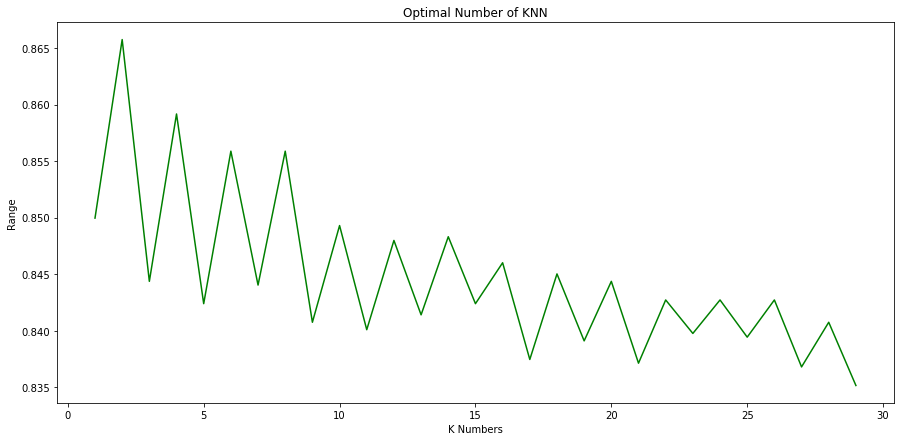

In [47]:
optimal_number_list = []
for each in range (1, 30):
    KNN = KNeighborsClassifier(n_neighbors = each)
    KNN.fit(X_train_re, y_train_re)
    
    optimal_number_list.append(KNN.score(X_test, y_test))
 

# plot the results on a graph

fig = plt.figure(figsize=(15,7))
plt.plot(range(1,30),optimal_number_list, color = "Green")
plt.xlabel("K Numbers")
plt.ylabel("Range")
plt.title("Optimal Number of KNN")


### Random Forest

Text(0.5, 1.0, 'Optimal Number of Trees in Random Forest')

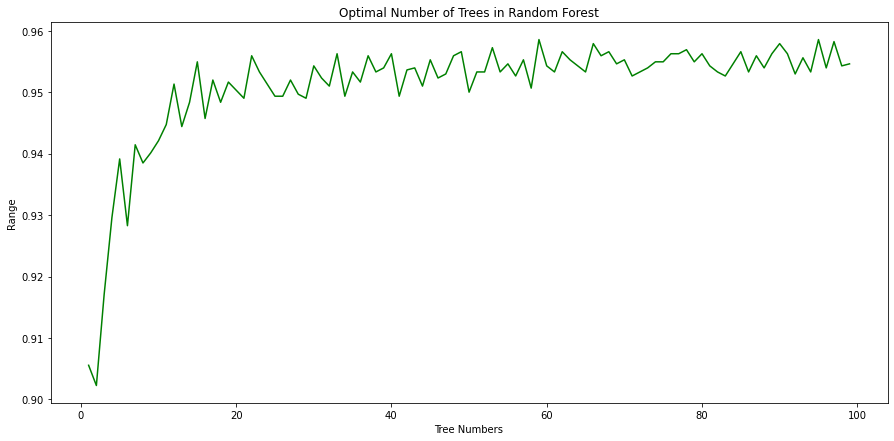

In [48]:
optimal_number_list = []
for each in range (1, 100):
    rfc = RandomForestClassifier(n_estimators = each)
    rfc.fit(X_train, y_train)
    
    optimal_number_list.append(rfc.score(X_test, y_test))
 

# plot the results on a graph

fig = plt.figure(figsize=(15,7))
plt.plot(range(1,100),optimal_number_list, color = "Green")
plt.xlabel("Tree Numbers")
plt.ylabel("Range")
plt.title("Optimal Number of Trees in Random Forest")

In [49]:
rfc = RandomForestClassifier(n_estimators=33)
rfc.fit(X_train, y_train)

# Predicting the Test set results
y_pred  = rfc.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

results1 = pd.DataFrame([['Random Forest_2', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
print (results1)

             Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  Random Forest_2  0.952287   0.916865  0.778226  0.841876  0.802495


### SVC

In [50]:
svc = SVC(kernel ='rbf', C=0.5)
svc.fit(X_train_re, y_train_re)

# Predicting the Test set results
y_pred  = svc.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

model_results1 = pd.DataFrame([['SVC', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
results1 = results1.append(model_results1, ignore_index = True)
print (results1)

             Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  Random Forest_2  0.952287   0.916865  0.778226  0.841876  0.802495
1              SVC  0.701876   0.311581  0.683468  0.428030  0.551758


### XGBoost

[16:53:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Feature Importances :  [0.03688172 0.03512251 0.01198702 0.00770968 0.01794126 0.10193671
 0.03238519 0.02852288 0.02405822 0.19452211 0.01522129 0.03300599
 0.05850253 0.23509957 0.04692186 0.02468367 0.01676156 0.02000967
 0.00987252 0.00810333 0.01192925 0.00834634 0.00639884 0.00175959
 0.         0.         0.01231665]


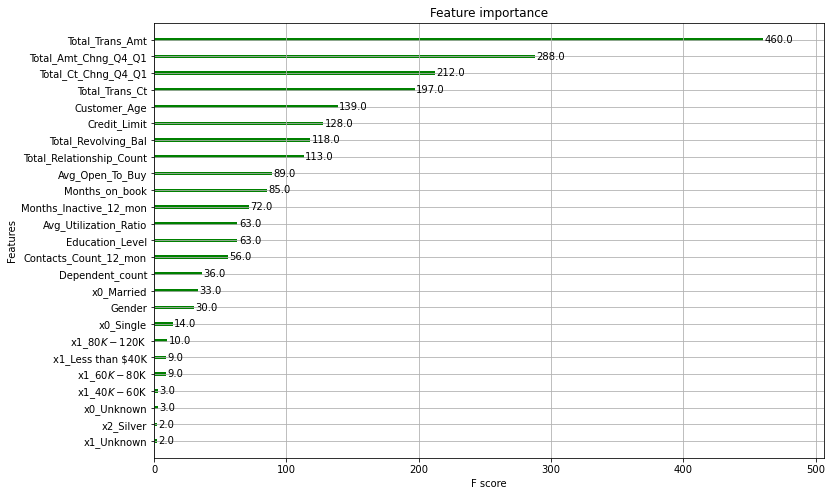

In [51]:
from xgboost import plot_importance

# fit model to training data
xgc = xgb.XGBClassifier(random_state = 42 )
xgc.fit(X_train, y_train)

print("Feature Importances : ", xgc.feature_importances_)

# plot feature importance
plot_importance(xgc)
plt.show()

In [52]:
from sklearn.feature_selection import SelectFromModel
selection = SelectFromModel(xgc)
selection.fit(X_train, y_train)

# Transform the train and test features
select_X_train = selection.transform(X_train)
select_X_test = selection.transform(X_test)

# train model
xgc.fit(select_X_train, y_train)

[16:53:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:53:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, predictor='auto', random_state=42,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [53]:
y_pred = xgc.predict(select_X_test)

xgc_ac = accuracy_score(y_test, y_pred)
xgc_fscore = f1_score(y_test ,y_pred)
f2 = fbeta_score(y_test, y_pred, beta=2.0)

print("Limited Features XGBoost Model Accuracy:", xgc_ac)
print("Limited Features XGBoost Model F1 Score:", xgc_fscore)
print("Limited Features XGBoost Model F2 Score:", f2)

Limited Features XGBoost Model Accuracy: 0.9512997696610728
Limited Features XGBoost Model F1 Score: 0.8445378151260504
Limited Features XGBoost Model F2 Score: 0.8237704918032787


### Choose and Evaluate Selected models

In [61]:
import xgboost as xgb 
xgc = xgb.XGBClassifier(n_estimators=500, max_depth=5, random_state=42) 
xgc.fit(X_train, y_train)

# Predicting the Test set results
y_pred  = xgc.predict(X_test)

#Evaluate results
acc = accuracy_score(y_test, y_pred )
prec = precision_score(y_test, y_pred )
rec = recall_score(y_test, y_pred )
f1 = f1_score(y_test, y_pred )
f2 = fbeta_score(y_test, y_pred, beta=2.0)

results2 = pd.DataFrame([['XGBClassifier', acc, prec, rec, f1, f2]], columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
print (results2)


[16:58:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
           Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0  XGBClassifier  0.964462   0.894309  0.887097  0.890688   0.88853


### Cross Validation with Stratified K-Fold method

In [55]:
from numpy import loadtxt
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import StratifiedKFold, cross_val_score, GridSearchCV

# CV model
xgc = xgb.XGBClassifier(n_estimators=500, max_depth=5, random_state=42)
kfold = StratifiedKFold(n_splits=10)
results = cross_val_score(xgc, X_train, y_train, cv=kfold)
print("Accuracy: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

[16:53:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:53:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:53:54] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:53:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

### Hyper Parameter Tunning

In [56]:
# Define the search space
param_grid = { 
    # Percentage of columns to be randomly samples for each tree.
    "colsample_bytree": [ 0.3, 0.5 , 0.8 ],
    
    # reg_alpha provides l1 regularization to the weight, higher values result in more conservative models
    "reg_alpha": [0, 0.5, 1, 5],
    
    # reg_lambda provides l2 regularization to the weight, higher values result in more conservative models
    "reg_lambda": [0, 0.5, 1, 5]
    }
# Set up score
scoring = ['f1']

In [57]:
# Define grid search
grid_search = GridSearchCV(estimator=xgc, 
                           param_grid=param_grid, 
                           scoring=scoring, 
                           refit='f1', 
                           n_jobs=-1, 
                           cv=kfold, 
                           verbose=0)
# Fit grid search
grid_result = grid_search.fit(X_train,y_train)
grid_result

# Print the best score and the corresponding hyperparameters
print(f'The best score is {grid_result.best_score_:.4f}')
print('The best score standard deviation is', round(grid_result.cv_results_['std_test_f1'][grid_result.best_index_], 4))
print(f'The best hyperparameters are {grid_result.best_params_}')

[16:57:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
The best score is 0.9217
The best score standard deviation is 0.0146
The best hyperparameters are {'colsample_bytree': 0.8, 'reg_alpha': 0.5, 'reg_lambda': 1}


In [58]:
# Make prediction using the best model
grid_predict = grid_search.predict(X_test)

# Get performance metrics
f1 = f1_score(y_test, grid_predict)

# Print result
f1

0.8879837067209776

# Model Interpretability

We are going to implore SHAP in Python to interprete our model. Other advanced techniques that can be used include LIME, ELI5 and SKATER among others.
SHAP has optimised functions for interpreting trr based models and a model agnostic explainer function for interpreting any black model for which the predictions are known.

The awesome aspect about this framework is while SHAP values can explain the output of any machine learning model, for really complex ensemble models it can be slow. But they have developed a high-speed exact algorithm for tree ensemble methods. Fast C++ implementations are supported for XGBoost, LightGBM, CatBoost, and scikit-learn tree models!

SHAP (SHapley Additive exPlanations) assigns each feature an importance value for a particular. Here we use the Tree SHAP implementation integrated into XGBoost to explain the test dataset! Remember that there are a variety of explainer methods based on the type of models you are building. We estimate the SHAP values for a set of samples (test data)

### Interprete Models with SHAP

In [59]:
import shap

# Need to load JS vis in the notebook
shap.initjs()

In [62]:
# creating an explainer for our model
explainer = shap.TreeExplainer(xgc)

# finding out the shap values using the explainer
shap_values = explainer.shap_values(X_test)

# Expected/Base/Reference value = the value that would be predicted if we didn’t know any features of the current output”
print('Expected Value:', explainer.expected_value)

Expected Value: -2.4887831


### Local Interpretaion

In [63]:
y_pred[0]

0

In [64]:
shap.force_plot(explainer.expected_value, shap_values[0], X_test.iloc[0])

SHAP gives a nice reasoning above showing which features were the most influential in the model, taking the correct decision of predicting the person’s churn category.

The explanation shows features each contributing to push the model output from the base value (the average model output over the training dataset we passed) to the actual model output.

<b>Features pushing the prediction higher are shown in red, those pushing the prediction lower are in blue.</b>

In [65]:
y_pred[13]

1

In [66]:
shap.force_plot(explainer.expected_value, shap_values[13], X_test.iloc[13])

In [67]:
shap.force_plot(explainer.expected_value, shap_values[:1000,:], X_test.iloc[:1000,:])

One good thing about SHAP is that it can interpret multiple predictions at once. 

### Global Interpretation

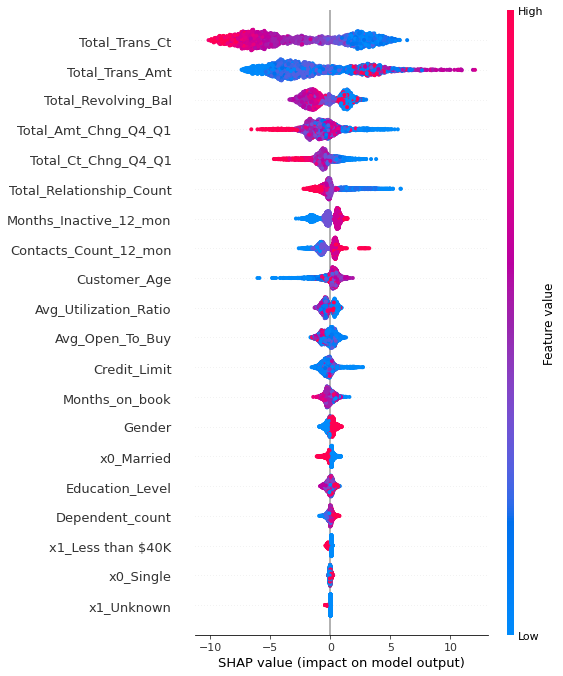

In [68]:
shap.summary_plot(shap_values, X_test)

We get the above plot by putting everything together under one roof. This shows the Shap values on the x-axis. 

Here, all the values on the left represent the observations that shift the predicted value in the negative direction while the points on the right contribute to shifting the prediction in a positive direction. All the features are on the left y-axis.

### SHAP Dependency Plots

SHAP dependence plots show the effect of a single (or two) feature across the whole dataset.

They plot a feature’s value vs. the SHAP value of that feature across many samples.

The syntax of Dependence Plots is dependence_plot(ind[, shap_values, …]).

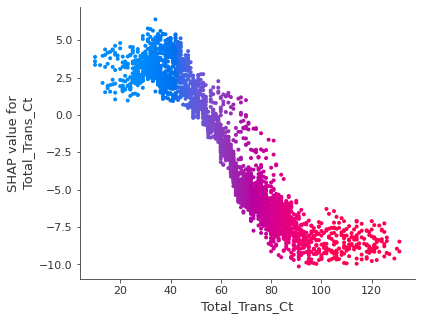

In [69]:
shap.initjs()
shap.dependence_plot(ind='Total_Trans_Ct', interaction_index='Total_Trans_Ct',
                     shap_values=shap_values, 
                     features=X_test)

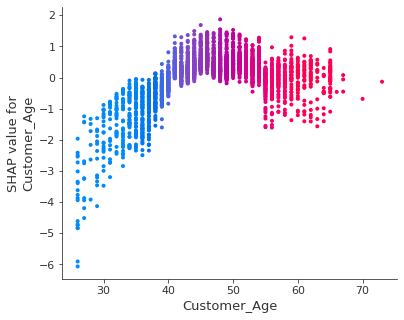

In [70]:
shap.initjs()
shap.dependence_plot(ind='Customer_Age', interaction_index='Customer_Age',
                     shap_values=shap_values, 
                     features=X_test)

In [71]:
import joblib

In [72]:
joblib_file = "joblib_CC_Model.pkl"
joblib.dump(xgc, joblib_file)

['joblib_CC_Model.pkl']